# Data4Good Micro Project, AQI Analysis

In [3]:
import requests
import pandas as pd

In [4]:
city = requests.get("https://website-api.airvisual.com/v1/routes/canada/alberta/calgary")

In [4]:
stations = requests.get(f"https://website-api.airvisual.com/v1/stations/by/cityID/{city.json().get('id')}?sortBy=aqi&sortOrder=asc&units.temperature=celsius&units.distance=kilometer&units.pressure=millibar&AQI=US&language=en")

In [11]:
print(stations.json()[0])

{'id': '5c652afdeff5bf47a1cac96a', 'name': 'Calgary Palliser', 'url': '/canada/alberta/calgary/calgary-palliser', 'aqi': 0}


In [12]:
station1 = requests.get(f"https://website-api.airvisual.com/v1/stations/{stations.json()[0].get('id')}/measurements?units.temperature=celsius&units.distance=kilometer&units.pressure=millibar&AQI=US&language=en")
station1_data = station1.json()

print(station1_data)
print(station1_data['properties'])

{'id': '5c652afdeff5bf47a1cac96a', 'measurements': {'hourly': [{'ts': '2022-03-19T04:00:00.000Z', 'aqi': 1, 'pm25': {'aqi': 1, 'concentration': 0.3}}, {'ts': '2022-03-19T05:00:00.000Z', 'aqi': 1, 'pm25': {'aqi': 1, 'concentration': 0.2}}, {'ts': '2022-03-19T06:00:00.000Z', 'aqi': 3, 'pm25': {'aqi': 3, 'concentration': 0.8}}, {'ts': '2022-03-19T07:00:00.000Z', 'aqi': 3, 'pm25': {'aqi': 3, 'concentration': 0.6}}, {'ts': '2022-03-19T08:00:00.000Z', 'aqi': 1, 'pm25': {'aqi': 1, 'concentration': 0.3}}, {'ts': '2022-03-19T09:00:00.000Z', 'aqi': 1, 'pm25': {'aqi': 1, 'concentration': 0.2}}, {'ts': '2022-03-19T10:00:00.000Z', 'aqi': 1, 'pm25': {'aqi': 1, 'concentration': 0.2}}, {'ts': '2022-03-19T11:00:00.000Z', 'aqi': 0, 'pm25': {'aqi': 0, 'concentration': 0.1}}, {'ts': '2022-03-19T12:00:00.000Z', 'aqi': 1, 'pm25': {'aqi': 1, 'concentration': 0.2}}, {'ts': '2022-03-19T13:00:00.000Z', 'aqi': 1, 'pm25': {'aqi': 1, 'concentration': 0.3}}, {'ts': '2022-03-19T14:00:00.000Z', 'aqi': 1, 'pm25': {'aq

KeyError: 'properties'

In [25]:
station1_df = pd.json_normalize(station1_data['measurements']['hourly'])

In [26]:
station1_df

,ts,aqi,co.aqi,co.concentration
0,2022-03-06T03:00:00.000Z,1.0,1.0,53.9
1,2022-03-06T04:00:00.000Z,1.0,1.0,59.7
2,2022-03-06T05:00:00.000Z,0.0,0.0,46.9
3,2022-03-06T06:00:00.000Z,0.0,0.0,37.7
4,2022-03-06T07:00:00.000Z,1.0,1.0,64.1
5,2022-03-06T08:00:00.000Z,1.0,1.0,52.9
6,2022-03-06T09:00:00.000Z,1.0,1.0,55.9
7,2022-03-06T10:00:00.000Z,0.0,0.0,50.0
8,2022-03-06T11:00:00.000Z,NaN,NaN,NaN
9,2022-03-06T12:00:00.000Z,0.0,0.0,31.9


In [7]:
# dictionary to store all the data frames per city
stations_measurements_map = {}

# For loop 
# count: using enumerate to access the json file later on using indexing
# station: all the information about the stations from the stations request
for count, station in enumerate(stations.json()):
    # Requests data for that station
    station_data = requests.get(f"https://website-api.airvisual.com/v1/stations/{stations.json()[count].get('id')}/measurements?units.temperature=celsius&units.distance=kilometer&units.pressure=millibar&AQI=US&language=en")
    
    # Converts the data of interest into a readeble format
    temp_daily_measurements = station_data.json()['measurements']['hourly']

    # Converts it into a pandas dataframe
    station_df = pd.json_normalize(temp_daily_measurements)

    # The NaN values in the aqi column are 0s, so we replace them with NaN values
    station_df['aqi'] = station_df['aqi'].replace(0, pd.NA)

    # Now use forward fill to fill in the NaN values with the latest available
    station_df = station_df.fillna(method='ffill')

    # Create datetime series for datetime ONLY during the first iteration of the loop
    if count == 0:
        dates = pd.to_datetime(station_df.iloc[:, 0]).dt.date

    # Since all of the time indexes are the same, we will be storing it in a seperate list to then use it for plotting
    # This drops the 'ts' column from all the dataframes being added
    stations_measurements_map[station['name']] = station_df.drop(columns=station_df.columns[0], axis=1)

print(dates)

print(stations_measurements_map)

0     2022-02-19
1     2022-02-20
2     2022-02-21
3     2022-02-22
4     2022-02-23
5     2022-02-24
6     2022-02-25
7     2022-02-26
8     2022-02-27
9     2022-02-28
10    2022-03-01
11    2022-03-02
12    2022-03-03
13    2022-03-04
14    2022-03-05
15    2022-03-06
16    2022-03-07
17    2022-03-08
18    2022-03-09
19    2022-03-10
20    2022-03-11
21    2022-03-12
22    2022-03-13
23    2022-03-14
24    2022-03-15
25    2022-03-16
26    2022-03-17
27    2022-03-18
28    2022-03-19
29    2022-03-20
30    2022-03-21
Name: ts, dtype: object
{'Calgary Palliser':      aqi  pm25.aqi  pm25.concentration
0    2.0       2.0                 0.6
1   10.0      10.0                 2.4
2   11.0      11.0                 2.6
3   11.0      11.0                 2.7
4   25.0      25.0                 6.1
5    7.0       7.0                 1.8
6    6.0       6.0                 1.5
7    5.0       5.0                 1.1
8    2.0       2.0                 0.5
9    4.0       4.0                 0.9

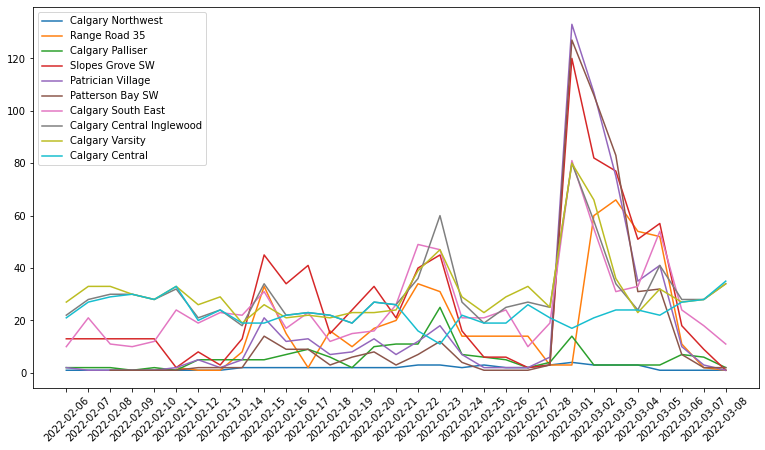

In [9]:
# Graph the data with pyplot just to see what it looks like

import matplotlib.pyplot as plt

fig, ax = plt.subplots(1, 1, figsize= (13, 7))

legend = []

for station, df in stations_measurements_map.items():
    ax.plot(df['aqi'])
    legend.append(station)

ax.set_xticks(dates.index, dates, rotation=45)

ax.legend(legend)

In [11]:
# Get the geojson file from the data.calgary.ca website for community boundaries
# source: https://data.calgary.ca/Base-Maps/Community-District-Boundaries/surr-xmvs

import json
calgary_neighbourhoods = json.load(open("Community District Boundaries.geojson"))

In [11]:
print(calgary_neighbourhoods['features'][0]['properties'])

{'comm_structure': 'EMPLOYMENT', 'name': 'EASTFIELD', 'sector': 'EAST', 'class_code': '2.0', 'srg': 'N/A', 'class': 'Industrial', 'comm_code': 'EFI'}


In [12]:
# Loop through geojson file to get the list of names for the locations and append them to a set
# We need to map the data from the AQI to this data so since we only have 9 stations, we have to distribute them acrross the areas in the city
locations_set = set()
for location in calgary_neighbourhoods['features']:
    if location['properties']['comm_structure'] != 'UNDEVELOPED':
        locations_set.add(location['properties']['name'])

# Create a set of the stations
stations_set = set(stations_measurements_map)

print(stations_set)
print(locations_set)


{'Calgary Northwest', 'Calgary South East', 'Slopes Grove SW', 'Calgary Varsity', 'Calgary Palliser', 'Patrician Village', 'Patterson Bay SW', 'Calgary Central', 'Range Road 35', 'Calgary Central Inglewood'}
{'CHINOOK PARK', 'SADDLE RIDGE INDUSTRIAL', 'MEADOWLARK PARK', 'QUEENSLAND', 'MARTINDALE', '02F', 'CITADEL', 'CRESTMONT', 'EAST FAIRVIEW INDUSTRIAL', 'KINCORA', 'LINCOLN PARK', 'THORNCLIFFE', 'POINT MCKAY', 'AURORA BUSINESS PARK', 'NORTH HAVEN', 'GREENVIEW', 'CLIFF BUNGALOW', 'CALGARY INTERNATIONAL AIRPORT', 'OGDEN SHOPS', 'PARKDALE', 'RAMSAY', 'ALBERT PARK/RADISSON HEIGHTS', 'LOWER MOUNT ROYAL', 'COUNTRY HILLS', 'STONEY 2', 'RANCHLANDS', 'PALLISER', 'SKYLINE WEST', '03W', 'SYMONS VALLEY RANCH', 'ROSEDALE', 'HIGHWOOD', 'MISSION', 'OGDEN', 'SILVERADO', 'ALPINE PARK', 'GLAMORGAN', 'CORNERSTONE', 'NORTH GLENMORE PARK', 'TWINHILLS', 'RUNDLE', 'WEST HILLHURST', 'MACEWAN GLEN', 'SHEPARD INDUSTRIAL', 'GOLDEN TRIANGLE', 'SANDSTONE VALLEY', 'SOUTHVIEW', 'ERIN WOODS', 'BURNS INDUSTRIAL', 'QU

In [13]:
import urllib.parse

# gets coordinates for all items in a SET, returns dictionary {location: (lat, lon)}
def get_coordinates_in_set(addresses):
    # Dictionary to store places
    places_with_coords = {}
    
    for place in addresses:
        # Parse address, and search for URL using NOMINATIM
        address = f"{place}, Calgary, AB"
        url = f'https://nominatim.openstreetmap.org/search/{urllib.parse.quote(address)}?format=json'
        response = requests.get(url).json()

        try:
            # Store in Dictionary
            places_with_coords[place] = (response[0]['lat'], response[0]['lon'])
        # If the index is out of range in the response, then it failed to query the coordinates, so we will have to manually input them
        except IndexError:
            print(f'Failed to get coordinates for: {place}')

    
    return places_with_coords

In [14]:
# Get the coordinates for all points in the stations and stores it in dictionary
stations_with_coords = get_coordinates_in_set(stations_set)

# Manually overwrite RR35 and Calgary Northwest
# RR35 Keeps returning a place in the opposite side of the city
# The Northwest returns a point that is too central and would mess with the other locations
stations_with_coords['Range Road 35'] = ('51.068225', '-114.396880')
stations_with_coords['Calgary Northwest'] = ('51.116406', '-114.139524')

In [15]:
print(stations_with_coords)

{'Calgary Northwest': ('51.116406', '-114.139524'), 'Calgary South East': ('50.9783769', '-114.011582'), 'Slopes Grove SW': ('51.03096815', '-114.225198982321'), 'Calgary Varsity': ('51.0876234', '-114.1578104'), 'Calgary Palliser': ('50.9618986', '-114.1185708'), 'Patrician Village': ('51.0696681', '-114.12699223529779'), 'Patterson Bay SW': ('51.0648247', '-114.1715761'), 'Calgary Central': ('51.045521300000004', '-114.05506789559041'), 'Range Road 35': ('51.068225', '-114.396880'), 'Calgary Central Inglewood': ('51.03080025', '-114.00882075893524')}


In [16]:
# Now do it for all the locations
locations_with_coords = get_coordinates_in_set(locations_set)

Failed to get coordinates for: 02F
Failed to get coordinates for: 03W
Failed to get coordinates for: QUEENS PARK VILLAGE
Failed to get coordinates for: GLENDEER BUSINESS PARK
Failed to get coordinates for: DEERFOOT BUSINESS CENTRE
Failed to get coordinates for: DOUGLASDALE/GLEN
Failed to get coordinates for: SECTION 23
Failed to get coordinates for: 02E


In [17]:
# Manually input locations for those that failed
locations_with_coords['DEERFOOT BUSINESS CENTRE'] = ('51.111932', '-114.042759')
locations_with_coords['SECTION 23'] = ('50.971781', '-113.970047')
locations_with_coords['03W'] = ('51.206961', '-114.043472')
locations_with_coords['GLENDEER BUSINESS PARK'] = ('50.988979', '-114.031828')
locations_with_coords['DOUGLASDALE/GLEN'] = ('50.942476', '-114.003172')
locations_with_coords['02F'] = ('51.155627', '-114.180945')
locations_with_coords['QUEENS PARK VILLAGE'] = ('51.084062', '-114.078695')
locations_with_coords['02E'] = ('51.157494', '-114.202538')

In [18]:
print(locations_with_coords)

{'CHINOOK PARK': ('50.9831231', '-114.0893006'), 'SADDLE RIDGE INDUSTRIAL': ('51.1256359', '-113.9767202'), 'MEADOWLARK PARK': ('50.9979466', '-114.0805013'), 'QUEENSLAND': ('50.9384595', '-114.0219679'), 'MARTINDALE': ('51.1181345', '-113.9590416'), 'CITADEL': ('51.145091', '-114.1757304'), 'CRESTMONT': ('51.0852147', '-114.2650718'), 'EAST FAIRVIEW INDUSTRIAL': ('50.9845303', '-114.0387994'), 'KINCORA': ('51.1584472', '-114.1330259'), 'LINCOLN PARK': ('51.0091676', '-114.1298428'), 'THORNCLIFFE': ('51.1060956', '-114.069411'), 'POINT MCKAY': ('51.0601668', '-114.146004'), 'AURORA BUSINESS PARK': ('51.1402011', '-114.06262787542387'), 'NORTH HAVEN': ('51.0971348', '-114.0887255'), 'GREENVIEW': ('51.0953824', '-114.058469'), 'CLIFF BUNGALOW': ('51.0344365', '-114.0738326'), 'CALGARY INTERNATIONAL AIRPORT': ('51.120751', '-114.01057234296194'), 'OGDEN SHOPS': ('50.9947144', '-113.997944'), 'PARKDALE': ('51.0606831', '-114.1391954'), 'RAMSAY': ('51.037727', '-114.041219'), 'ALBERT PARK/R

In [19]:
from geopy.distance import distance

# Algorithm co-written by Matthew McConnell and I, used to find shortest distance between two points
# Returns: Dictionary containing all sectors as keys and the closest station as values
locations_mapped_to_stations = {}

for loc_name, loc_coords in locations_with_coords.items():
    smallest_dist = float('inf')
    closest_station = ""
    for station_name, station_coords in stations_with_coords.items():
        curr_dist = distance(station_coords, loc_coords).km
        if curr_dist < smallest_dist:
            smallest_dist = curr_dist
            closest_station = station_name

    locations_mapped_to_stations[loc_name] = closest_station

In [20]:
print(locations_mapped_to_stations)

{'CHINOOK PARK': 'Calgary Palliser', 'SADDLE RIDGE INDUSTRIAL': 'Calgary Central', 'MEADOWLARK PARK': 'Calgary Palliser', 'QUEENSLAND': 'Calgary South East', 'MARTINDALE': 'Calgary Central Inglewood', 'CITADEL': 'Calgary Northwest', 'CRESTMONT': 'Slopes Grove SW', 'EAST FAIRVIEW INDUSTRIAL': 'Calgary South East', 'KINCORA': 'Calgary Northwest', 'LINCOLN PARK': 'Calgary Palliser', 'THORNCLIFFE': 'Calgary Northwest', 'POINT MCKAY': 'Patrician Village', 'AURORA BUSINESS PARK': 'Calgary Northwest', 'NORTH HAVEN': 'Patrician Village', 'GREENVIEW': 'Calgary Central', 'CLIFF BUNGALOW': 'Calgary Central', 'CALGARY INTERNATIONAL AIRPORT': 'Calgary Central', 'OGDEN SHOPS': 'Calgary South East', 'PARKDALE': 'Patrician Village', 'RAMSAY': 'Calgary Central', 'ALBERT PARK/RADISSON HEIGHTS': 'Calgary Central Inglewood', 'LOWER MOUNT ROYAL': 'Calgary Central', 'COUNTRY HILLS': 'Calgary Northwest', 'STONEY 2': 'Patterson Bay SW', 'RANCHLANDS': 'Calgary Northwest', 'PALLISER': 'Calgary Palliser', 'SKYLI

In [21]:
# Now, using this dictionary, lets create a an attribute in the properties section of the json file that has this station name 
for location in calgary_neighbourhoods['features']:
    if location['properties']['comm_structure'] != 'UNDEVELOPED':
        location['properties']['station_name'] = locations_mapped_to_stations.get(location['properties']['name'])

In [22]:
# Make a test dataframe to use with the chloropleth using the last recorded observation
test_df = pd.DataFrame()
for station, df in stations_measurements_map.items():
    observation = pd.DataFrame(df.iloc[-1].copy()).transpose()
    observation['station_name'] = station
    aqi_station = observation.loc[:, ['station_name', 'aqi']]

    test_df = pd.concat([test_df, aqi_station], ignore_index=True)

print(test_df)

                station_name   aqi
0          Calgary Northwest   1.0
1              Range Road 35   1.0
2           Calgary Palliser   2.0
3            Slopes Grove SW   1.0
4          Patrician Village   1.0
5           Patterson Bay SW   2.0
6         Calgary South East  11.0
7  Calgary Central Inglewood  34.0
8            Calgary Varsity  34.0
9            Calgary Central  35.0


In [23]:
locations_df = pd.DataFrame.from_dict(locations_mapped_to_stations, orient='index', columns=['station_name'])
locations_df = locations_df.reset_index().rename(columns={'index':'name'})
locations_aqi_df = locations_df.merge(test_df, on='station_name')
print(locations_aqi_df)

                name      station_name   aqi
0       CHINOOK PARK  Calgary Palliser   2.0
1    MEADOWLARK PARK  Calgary Palliser   2.0
2       LINCOLN PARK  Calgary Palliser   2.0
3           PALLISER  Calgary Palliser   2.0
4          SILVERADO  Calgary Palliser   2.0
..               ...               ...   ...
262        BRENTWOOD   Calgary Varsity  34.0
263          TUSCANY   Calgary Varsity  34.0
264          VARSITY   Calgary Varsity  34.0
265          BOWNESS   Calgary Varsity  34.0
266         HASKAYNE   Calgary Varsity  34.0

[267 rows x 3 columns]


In [11]:
from AQScripts import *

# Request station data
stations = get_stations()

# Retrieve the latest possible data
# This method also cleans it and fills in the Nan values
data_df = get_latest_data(stations = stations)

# Get the coordinates for each station from the json file
stations_with_coords = get_station_coords(stations = stations)

# Load the geojson file for plotly and for mapping
calgary_sectors = json.load(open("Community District Boundaries.geojson"))

# Get the coordinates for each MultiPolygon by finding the center of each
sectors_with_coords = get_city_sectors(sectors_json = calgary_sectors)

# Map all the sectors to their closest stations
sectors_mapped = map_closest_station(
    sectors = sectors_with_coords,
    stations = stations_with_coords
)

# Merge all the data into one datafram
main_df = merge_sector_data(
    sectors_mapped = sectors_mapped,
    data_df = data_df)

In [12]:
import plotly.express as px

In [13]:
fig = px.choropleth_mapbox(main_df,
                locations='name',
                featureidkey='properties.name',
                geojson=calgary_sectors,
                color='aqi',
                mapbox_style='carto-positron',
                center={'lat':51.033639, 'lon':-114.059655},
                zoom=8.2,
                opacity=0.7,
                title="Calgary's Air Quality By Sector Using Air Quality Index (AQI)")
# fig.update_geos(fitbounds='locations')
fig.show()